In [161]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns

In [162]:
a=['SRR10836665','SRR10836673','SRR10836664']
t=['SRR10836670','SRR10836671','SRR10836672']
y=['SRR10836667','SRR10836668','SRR10836669']
for s in a+t+y:
    if s=='SRR10836665':
        df=pd.read_csv('../data/srr/'+s+'/quant.sf',sep='\t',index_col=0)[['TPM']]
        df.columns=[s]
    else:
        d=pd.read_csv('../data/srr/'+s+'/quant.sf',sep='\t',index_col=0)[['TPM']]
        d.columns=[s]
        df=df.merge(d,left_index=True,right_index=True)
df=df[a+t+y]
df.head()

,SRR10836665,SRR10836673,SRR10836664,SRR10836670,SRR10836671,SRR10836672,SRR10836667,SRR10836668,SRR10836669
Name,,,,,,,,,
ENST00000632684.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ENST00000434970.2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ENST00000448914.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ENST00000415118.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
ENST00000390583.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [163]:
df.loc['ENST00000541267.5']

SRR10836665        0.354244
SRR10836673        0.000000
SRR10836664        0.000000
SRR10836670    12348.351988
SRR10836671     3080.314921
SRR10836672     5893.429030
SRR10836667        0.000000
SRR10836668        0.208642
SRR10836669        0.000000
Name: ENST00000541267.5, dtype: float64

In [164]:
df['a']=df[a].mean(1)
df['t']=df[t].mean(1)
df['y']=df[y].mean(1)
df=df.sort_values('y')

In [165]:
df['ta']=(df.t)/(df.a+.01)
df['ya']=(df.y)/(df.a+.01)
df['ay']=(df.a)/(df.y+.01)
df.shape

(175775, 15)

In [166]:
d=np.log2(df+.1)
d=d[(d.ay>5)|(d.ya>5)]
print(d.shape)

(24904, 15)


<AxesSubplot:ylabel='Name'>

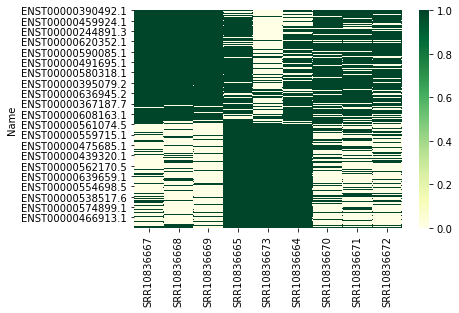

In [167]:
d['m']=d[y+a].mean(1)
for c in d.columns:
    d[c]=d[c]-d.m
d=d.sort_values('y')
sns.heatmap(d[y+a+t]<0,cmap="YlGn")

In [168]:
dg=pd.read_csv('../data/mart_export.txt',sep='\t',index_col=2).merge(df,left_index=True,right_index=True)
dg=dg[~dg['Gene name'].str.startswith('MT-')]
dg.shape

(154942, 17)

In [169]:
#dg=dg.groupby('Gene stable ID').mean()
aa=['GSM4227385','GSM4227387','GSM4227389','GSM4227391']
for c in aa:
    dg[c]=dg.a
tt=['GSM4227386','GSM4227388','GSM4227390','GSM4227392']
for c in tt:
    dg[c]=dg.t
dg[aa+tt].round(2).to_csv('../data/expf.csv')

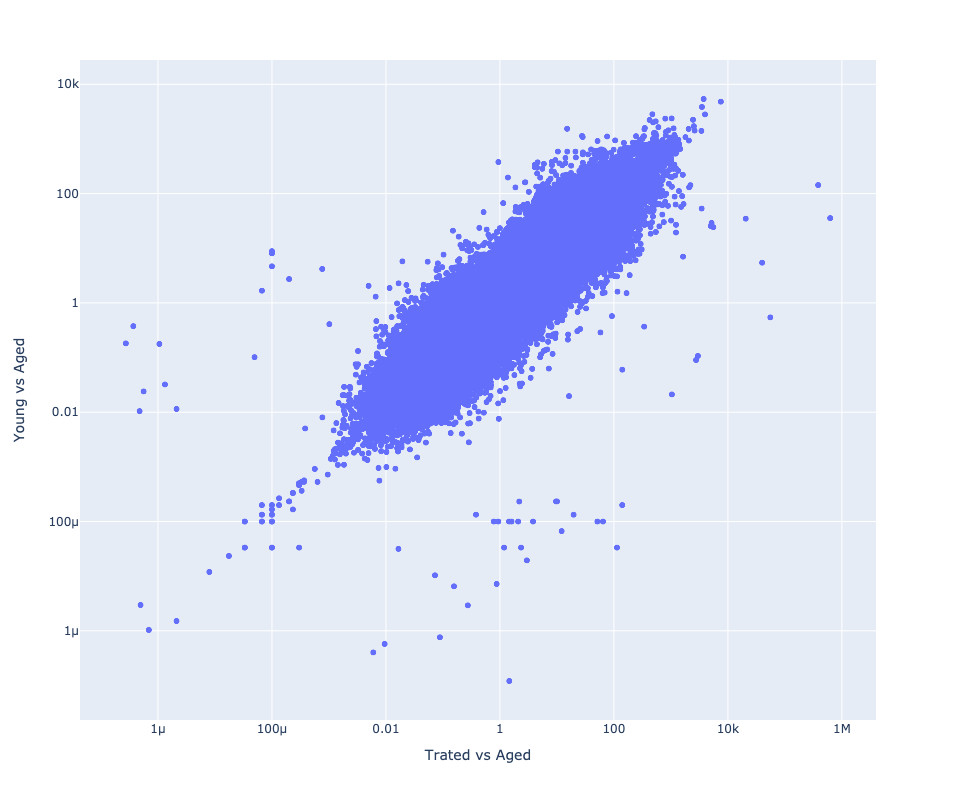

In [170]:
dg['gene']=dg['Gene name']
fig = px.scatter(dg, x="ta", y="ya",hover_data=['gene'], log_x=True,log_y=True,width=1000, height=800,
                labels={
                     "ta": "Trated vs Aged",
                     "ya": "Young vs Aged",
                 },
                )
fig.show()
dg.index=dg.gene.values
dg=dg.drop(['gene','ay'],1)

In [180]:
dg['ya']=dg.y-dg.a
dg['ta']=dg.t-dg.a

dg[['a','y','t','ta','ya']].sort_values('ya').tail(20)

,a,y,t,ta,ya
MYL6,1120.384764,1663.942782,1705.261223,584.876459,543.558018
PPIA,971.492354,1518.927373,1244.630942,273.138588,547.435019
TMSB4XP6,474.577921,1035.793859,785.241693,310.663772,561.215938
RPL31,993.516894,1565.678789,1563.495540,569.978646,572.161896
RPL21P16,500.867084,1087.818419,902.772285,401.905201,586.951334
RNA5SP202,273.846763,863.573716,505.241635,231.394872,589.726953
RPS17,1141.764582,1734.112634,1447.342986,305.578404,592.348051
TUBA1B,1853.437710,2450.705141,936.015898,-917.421812,597.267430
RPL39P3,477.009874,1081.964329,958.890108,481.880234,604.954455
RPS19,1646.891304,2281.141942,2361.423171,714.531867,634.250639


In [177]:
dg.loc['S100A4'][['a','y','t','ta','ya']]

,a,y,t,ta,ya
S100A4,87.340972,157.747212,93.124960,1.066101,1.805901
S100A4,624.846752,1056.709685,804.810883,1.287993,1.691123
S100A4,225.280870,270.488103,159.948300,0.709964,1.200617
S100A4,69.466308,68.334986,65.119088,0.937285,0.983573
S100A4,263.956862,310.809653,252.353801,0.956006,1.177457


In [349]:
rp=dg[dg['Gene name'].str.startswith('RPL') | dg['Gene name'].str.startswith('RPS')]

<AxesSubplot:xlabel='ta', ylabel='ya'>

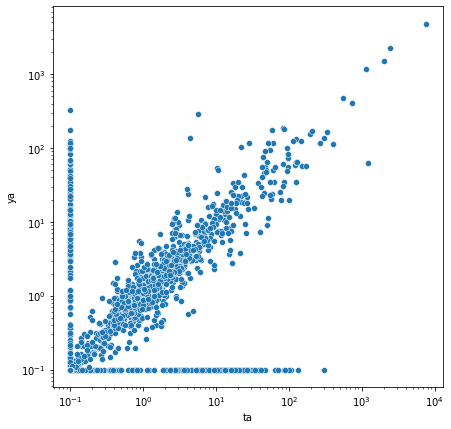

In [386]:
f,ax=f, ax = plt.subplots(figsize=(7, 7))
ax.set(xscale="log", yscale="log")
sns.scatterplot(data=rp[['ta','ya']]+.1,x='ta',y='ya',ax=ax)

In [387]:
rna=dg[dg['Gene name'].str.startswith('RNA') ]

<AxesSubplot:xlabel='ta', ylabel='ya'>

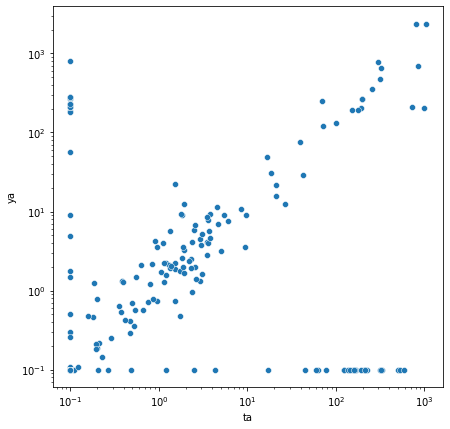

In [389]:
f,ax=f, ax = plt.subplots(figsize=(7, 7))
ax.set(xscale="log", yscale="log")
sns.scatterplot(data=rna[['ta','ya']]+.1,x='ta',y='ya',ax=ax)